# Analyse Exploratoire du Dataset des Maisons
Dans ce notebook, nous allons analyser un dataset contenant des informations sur des maisons, explorer les relations entre les variables, et préparer les données pour la construction d'un modèle de régression.

## 1. Chargement des Librairies et du Dataset
Nous allons d'abord charger les librairies nécessaires et importer le dataset.

In [ ]:
# Importer les librairies nécessaires
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

url = "https://raw.githubusercontent.com/Fred-Zang/AJC_bigdata_python_analyse_donnees/main/data/kc_house_data_modified.csv"
house_data = pd.read_csv(url)

# Afficher les premières lignes du dataset
house_data.sample(10)


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
2745,8934100125,20140829T000000,810000.0,3,2.00,2870.0,6360,1.5,0,1.0,...,8,1790,1080,1946,0,98115.0,47.6813,-122.275,2310,6466
4999,6430500010,20140620T000000,547000.0,5,2.50,2200.0,4080,1.5,0,0.0,...,7,1420,780,1916,0,98103.0,47.6872,-122.350,1300,4080
16732,8643000185,20150430T000000,237100.0,3,1.75,1360.0,9603,1.0,0,0.0,...,7,1360,0,1963,0,98198.0,47.3959,-122.309,2240,10605
6122,6668900020,20150318T000000,420550.0,4,2.00,1370.0,8100,1.0,0,0.0,...,7,1370,0,1947,0,98155.0,47.7490,-122.312,1280,8100
3136,1023059313,20150205T000000,390000.0,3,2.50,1910.0,4755,2.0,0,0.0,...,8,1910,0,1997,0,98059.0,47.4956,-122.162,2460,6099
20221,993000307,20140523T000000,360000.0,3,2.00,1270.0,1323,3.0,0,0.0,...,8,1270,0,2006,0,98103.0,47.6934,-122.342,1330,1323
19599,2490200220,20150302T000000,515000.0,3,1.50,1660.0,5100,1.0,0,0.0,...,7,1210,450,1954,0,98136.0,47.5345,-122.383,1440,5100
8210,2946003580,20141119T000000,203000.0,3,1.50,1370.0,7500,1.0,0,0.0,...,7,1080,290,1958,0,98198.0,47.4167,-122.322,1400,7500
20967,3630220180,20140708T000000,812000.0,4,3.50,3370.0,3634,2.0,0,0.0,...,9,2750,620,2007,0,98029.0,47.5519,-122.001,3200,3650
8417,4027700594,20141222T000000,520000.0,3,1.75,2310.0,36665,1.0,0,2.0,...,8,1580,730,1983,0,98155.0,47.7697,-122.274,2000,14000


# 2. Exploration Initiale du Dataset
Nous allons explorer le dataset pour comprendre sa structure, les types de variables qu'il contient, et obtenir un aperçu général des données.

In [374]:
# Afficher des informations générales sur le dataset
house_data.info()

# Vérifier les statistiques descriptives des colonnes numériques
house_data.describe()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  float64
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21181 non-null  float64
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        19019 non-null  float64
 17  lat            21613 non-null  float64
 18  long  

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21181.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,19019.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,4.580302e+09,5.888233e+05,3.370842,2.114757,2163.612627,1.510697e+04,1.494309,0.007542,0.234880,3.409430,7.656873,1788.390691,291.509045,1971.005136,84.402258,98078.037436,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,6.060923e+05,0.930062,0.770163,1232.705581,4.142051e+04,0.539989,0.086517,0.766893,0.650743,1.175459,828.090978,442.575043,29.373411,401.679240,53.527745,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.245000e+05,3.000000,1.750000,1430.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.530000e+05,3.000000,2.250000,1930.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,6.500000e+05,4.000000,2.500000,2577.000000,1.068800e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


### Résumé des informations descriptives du dataset : (à compléter)
- id : identifiant
- price : Le prix des maisons 
- bedrooms : Le nombre de chambres 
- bathrooms : Le nombre de salles de bain 
- sqft_living : La surface habitable
- floors : Le nombre d'étages
- waterfront : Indicateur de vue sur l'eau (0 : pas de vue, 1 : vue)
- yr_built : Les maisons datent de 1900 à 2015
- zipcode : Code postal des maisons
- lat et long : Coordonnées géographiques (latitude et longitude) des maisons.
- sqft_living15 : Surface habitable moyenne des 15 maisons les plus proches.
- sqft_lot15 : Surface moyenne du terrain des 15 maisons les plus proches.

## 3. Nettoyage, Préparation des Données et Normalisation
nous allons débugger et nettoyer le dataset afin de le rendre propre pour l'entraînement de modèles de régression.

### A. Gestion des Valeurs Manquantes
Nous allons d'abord identifier les lignes contenant des valeurs manquantes et les traiter.

In [469]:
# Vérifier la présence de valeurs manquantes
missing_values = house_data.isnull().sum()
print(missing_values)


id                  0
date                0
price               0
bedrooms            0
bathrooms           0
sqft_living         0
sqft_lot            0
floors              0
waterfront          0
view              432
condition           0
grade               0
sqft_above          0
sqft_basement       0
yr_built            0
yr_renovated        0
zipcode          2594
lat                 0
long                0
sqft_living15       0
sqft_lot15          0
dtype: int64


Nous avons plusieurs façons de gérer les valeurs manquantes :

1. Supprimer les lignes contenant des valeurs manquantes.
2. Remplacer les valeurs manquantes par la médiane ou la moyenne.


In [471]:
# exemple pour remplacer par la médiane
#house_data['bedrooms'].fillna(house_data['bedrooms'].median(), inplace=True) # fillna() remplace les valeurs manquantes par la médiane de la colonne

# nous préférons éliminer les lignes où il y a un Nan car gros dataset
# Supprimer les lignes où des NaN sont présents
house_data.dropna(inplace=True)

# Vérifier s'il reste des valeurs manquantes
print(house_data.isnull().sum())


id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64


### B. Suppression de la Colonne "id"
La colonne id est une simple clé unique qui n'apporte aucune information utile pour la modélisation. Nous allons donc la supprimer.

In [473]:
# Suppression de la colonne 'id'
house_data.drop(columns=['id'], inplace=True)

# Vérifier que la colonne a bien été supprimée
print(house_data.columns)


Index(['date', 'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15'],
      dtype='object')


### C.Reformater la Colonne "date" en Format DateTime
La colonne date est actuellement une chaîne de caractères. Nous allons la reformater en format datetime pour qu'elle soit plus facilement manipulable.

In [475]:
# Reformater la colonne 'date' au format datetime
house_data['date'] = pd.to_datetime(house_data['date'], format='%Y%m%dT%H%M%S')

# Afficher les premières lignes pour vérifier le changement
print(house_data['date'].head())


0   2014-10-13
1   2014-12-09
2   2015-02-25
3   2014-12-09
4   2015-02-18
Name: date, dtype: datetime64[ns]


### D. Détection et Gestion des Valeurs Aberrantes
Les valeurs aberrantes sont des points de données qui s'écartent anormalement des autres observations. Nous allons détecter ces valeurs dans les colonnes price et sqft_living, où nous avons introduit des valeurs extrêmes.

Étape 1 : Détection des valeurs aberrantes à l'aide d'un graphique
Nous allons utiliser des boîtes à moustaches (boxplots) pour détecter visuellement les valeurs aberrantes dans les colonnes price et sqft_living.

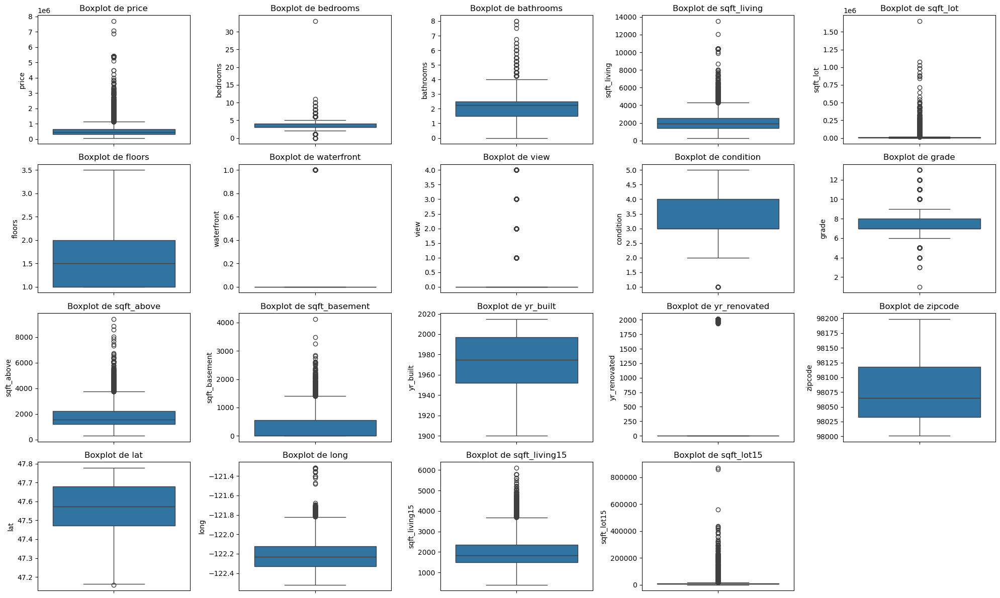

In [477]:
import matplotlib.pyplot as plt
import seaborn as sns

# Sélectionner uniquement les colonnes numériques pour les boxplots
numeric_columns = house_data.select_dtypes(include=['float64', 'int64']).columns

# Créer une grille de sous-plots pour afficher les boxplots
plt.figure(figsize=(20, 12))
for i, column in enumerate(numeric_columns, 1):
    plt.subplot(4, 5, i)  # Créer une grille 4x5 (modifiable selon le nombre de colonnes)
    sns.boxplot(y=house_data[column])
    plt.title(f'Boxplot de {column}')

plt.tight_layout()  # Pour éviter les chevauchements
plt.show()



### E. Suppression des colonnes inutiles
- waterfront : La majorité des maisons n'ont pas de vue sur l'eau (la colonne est essentiellement binaire, avec très peu de maisons ayant une vue sur l'eau).
- view : Les boxplots montrent que cette colonne a des valeurs très concentrées.
- zipcode : inutile et nous gardons longitude et latitude

In [387]:
# Suppression des colonnes 'waterfront', 'view', et 'zipcode'
house_data.drop(columns=['waterfront', 'view', 'zipcode', 'yr_renovated'], inplace=True)

# Vérifier les colonnes restantes
print(house_data.columns)



Index(['date', 'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors', 'condition', 'grade', 'sqft_above', 'sqft_basement',
       'yr_built', 'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')


### F. Nettoyage des Valeurs Aberrantes à l'aide de l'IQR
Ensuite, nous allons utiliser la méthode de l'IQR pour supprimer les valeurs aberrantes dans les colonnes restantes qui sont importantes pour le modèle. Nous nous concentrerons sur les colonnes avec de nombreuses valeurs aberrantes, comme :

- price
- sqft_living
- bathrooms
- bedrooms
- sqft_lot
- sqft_above
- sqft_basement


In [479]:
# Liste des colonnes à nettoyer pour les valeurs aberrantes
columns_to_clean = ['price', 'sqft_living', 'bathrooms', 'bedrooms', 'sqft_lot', 'sqft_above', 'sqft_basement']

# Appliquer la méthode de l'IQR pour chaque colonne
for column in columns_to_clean:
    Q1 = house_data[column].quantile(0.25)
    Q3 = house_data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    # Filtrer les valeurs dans les bornes acceptables
    house_data = house_data[(house_data[column] >= lower_bound) & (house_data[column] <= upper_bound)]

# Vérifier les nouvelles dimensions du dataset après le nettoyage
print(house_data.shape)


(14275, 20)


## G. Normalisation
### Critères pour la normalisation :
- Régression linéaire : Ce modèle est sensible à l'échelle des données. Il est donc souvent recommandé de normaliser ou standardiser les colonnes si elles ont des plages de valeurs très différentes.
- Régression par forêt aléatoire : Ce modèle est moins sensible aux différences d'échelle, mais il peut tout de même être utile de normaliser certaines colonnes pour garantir une meilleure convergence et des performances plus constantes.

In [391]:
# refaire un describe() final après notre nettoyage pour décider les features à normaliser ou non
house_data.describe()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,condition,grade,sqft_above,sqft_basement,yr_built,lat,long,sqft_living15,sqft_lot15
count,14275,1.427500e+04,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000
mean,2014-10-29 22:20:20.091068160,4.516283e+05,3.252049,1.978231,1818.196287,7076.540876,1.467215,3.413310,7.399860,1578.174291,240.021996,1969.634326,47.559070,-122.230348,1810.774221,7107.047496
min,2014-05-02 00:00:00,7.800000e+04,2.000000,0.500000,440.000000,520.000000,1.000000,1.000000,4.000000,440.000000,0.000000,1900.000000,47.189500,-122.512000,460.000000,651.000000
25%,2014-07-23 00:00:00,3.036985e+05,3.000000,1.500000,1350.000000,4744.500000,1.000000,3.000000,7.000000,1140.000000,0.000000,1950.000000,47.466800,-122.338000,1430.000000,4804.000000
50%,2014-10-17 00:00:00,4.150000e+05,3.000000,2.000000,1760.000000,7093.000000,1.000000,3.000000,7.000000,1440.000000,0.000000,1970.000000,47.568900,-122.270000,1720.000000,7200.000000
75%,2015-02-18 00:00:00,5.650000e+05,4.000000,2.500000,2230.000000,9050.000000,2.000000,4.000000,8.000000,1920.000000,490.000000,1996.000000,47.680400,-122.153000,2120.000000,8800.000000
max,2015-05-24 00:00:00,1.137500e+06,5.000000,4.000000,3990.000000,17965.000000,3.500000,5.000000,11.000000,3223.000000,1270.000000,2015.000000,47.777600,-121.319000,4410.000000,196591.000000
std,NaN,1.926785e+05,0.773181,0.664729,610.798297,3389.268270,0.545027,0.648527,0.899364,582.613002,354.566743,29.818872,0.139249,0.132152,519.764581,4040.917809


### Colonnes à normaliser :
- sqft_living : Plage large, de 440 à 3990, avec une moyenne autour de 1815. Ce type de colonne bénéficierait de la normalisation.
  
- sqft_lot : Très grande variation, allant de 520 à 17965, suggérant une normalisation nécessaire.
  
- sqft_above : Également large plage de valeurs, de 440 à 3223, normalisation recommandée.
  
- sqft_basement : De 0 à 1270, peut être normalisé, surtout avec la régression linéaire.
  
- sqft_living15 et sqft_lot15 : Variations similaires aux autres colonnes de surfaces, la normalisation serait utile.
  
### Colonnes probablement sans besoin de normalisation :
- bedrooms et bathrooms : Ce sont des compteurs discrets avec une plage limitée.
  
- floors : Les valeurs sont assez faibles (entre 1 et 3.5).
  
- condition, grade : Ce sont des colonnes catégoriques ordinales, qui ne nécessitent pas de normalisation.
  
- yr_built : Les années peuvent être traitées telles quelles, mais la standardisation peut être envisagée si leur impact est important dans le modèle
  
- lat et long : Ce sont des coordonnées géographiques, nous voulons les concerver intactes

### StandardScaler
## Cette méthode transformera les colonnes en ayant une moyenne de 0 et un écart-type de 1

In [394]:
from sklearn.preprocessing import StandardScaler

# Liste des colonnes à normaliser
columns_to_normalize = ['sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement', 'sqft_living15', 'sqft_lot15']

# Initialiser le StandardScaler
scaler = StandardScaler()

# Appliquer la normalisation uniquement sur les colonnes sélectionnées
house_data[columns_to_normalize] = scaler.fit_transform(house_data[columns_to_normalize])

# Vérifier les résultats
print(house_data[columns_to_normalize].head())


   sqft_living  sqft_lot  sqft_above  sqft_basement  sqft_living15  sqft_lot15
0    -1.044893 -0.420914   -0.683452      -0.676968      -0.905777   -0.360586
1     1.230897  0.048820    1.015848       0.451209      -0.232371    0.131646
2    -1.716169  0.862594   -1.387203      -0.676968       1.749364    0.236329
3     0.232169 -0.612703   -0.906593       1.889634      -0.867297   -0.521446
4    -0.226263  0.296080    0.174780      -0.676968      -0.020730    0.097989


# 4. Analyse des Corrélations entre les Variables
Pour mieux comprendre la relation entre les variables, nous allons analyser la matrice de corrélation et voir quelles variables sont les plus corrélées avec le prix des maisons.

price            1.000000
grade            0.558759
sqft_living      0.540863
sqft_living15    0.474824
lat              0.471011
sqft_above       0.416300
bathrooms        0.374403
sqft_basement    0.247672
bedrooms         0.246458
floors           0.242682
condition        0.069406
date             0.008408
long            -0.022073
yr_built        -0.032235
sqft_lot        -0.066756
sqft_lot15      -0.068261
Name: price, dtype: float64


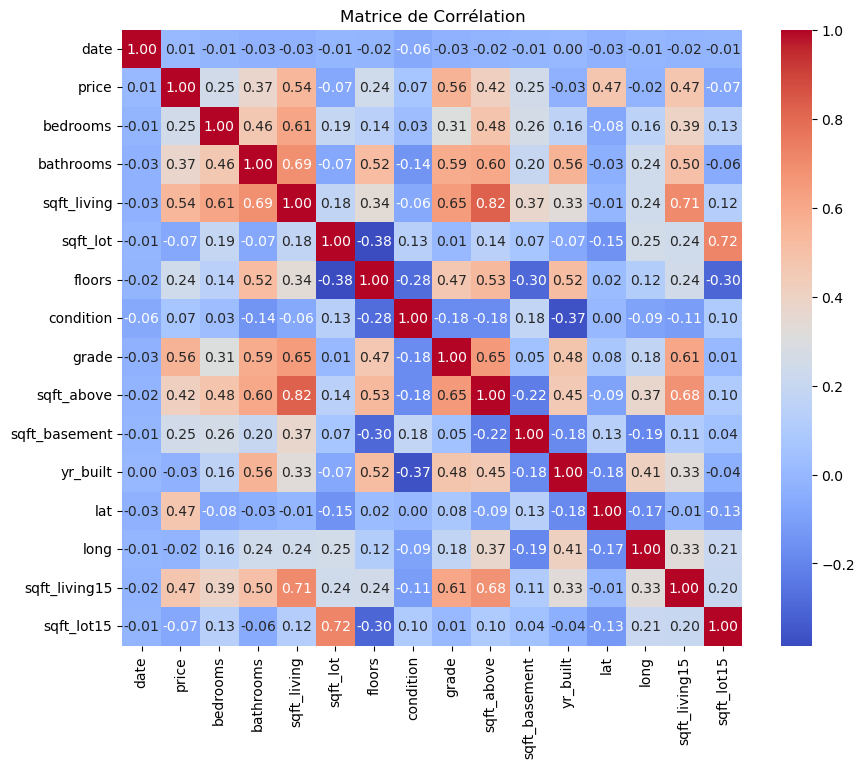

In [396]:
# Calculer la matrice de corrélation
correlation_matrix = house_data.corr()

# Afficher la corrélation des variables avec le prix
print(correlation_matrix['price'].sort_values(ascending=False))

# Visualisation de la matrice de corrélation
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Matrice de Corrélation')
plt.show()


### A. Justification de la sélection des features :
1. Caractéristiques à conserver :
- sqft_living (0.70) : C'est la caractéristique la plus fortement corrélée avec price. La surface habitable a un impact direct sur le prix des maisons.
- grade (0.55) : Le grade de la maison, qui reflète la qualité de la construction et du design, a une corrélation notable avec le prix.
- sqft_above (0.48) : La surface au-dessus du sol a une bonne corrélation avec price et est également pertinente pour le modèle.
- bathrooms (0.53) : Le nombre de salles de bain est également corrélé au prix, un facteur important dans la valorisation immobilière.
- sqft_living15 (0.47) : La surface habitable moyenne des 15 maisons les plus proches peut influencer le prix de manière indirecte.
- sqft_basement (0.32) : Bien que la corrélation soit plus faible, elle reste importante pour la surface totale et donc le prix.
  
2. Caractéristiques à exclure :
- bedrooms (0.23) : Bien que cette colonne soit pertinente, la corrélation avec price est relativement plus faible que celle des autres caractéristiques.
- sqft_lot (0.07) : La taille du terrain ne semble pas significativement influencer le prix.
- floors (0.25) : Le nombre d'étages a une faible corrélation avec le prix.
- condition (0.03) : La corrélation est très faible, donc cette colonne sera écartée.
- yr_built (0.05) : Bien que l'année de construction ou de rénovation puisse avoir un effet, ces colonnes présentent une faible corrélation avec le prix, et peuvent être négligées pour simplifier le modèle.

In [481]:
# Sélectionner les colonnes pertinentes pour la modélisation
selected_columns = ['price', 'sqft_living', 'grade', 'sqft_above', 'bathrooms', 'sqft_living15', 'sqft_basement']

# Filtrer le dataset avec les colonnes sélectionnées
house_data_selected = house_data[selected_columns]

# Vérifier les premières lignes du dataset filtré
house_data_selected.describe()


,price,sqft_living,grade,sqft_above,bathrooms,sqft_living15,sqft_basement
count,1.427500e+04,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000,14275.000000
mean,4.516283e+05,1818.196287,7.399860,1578.174291,1.978231,1810.774221,240.021996
std,1.926785e+05,610.798297,0.899364,582.613002,0.664729,519.764581,354.566743
min,7.800000e+04,440.000000,4.000000,440.000000,0.500000,460.000000,0.000000
25%,3.036985e+05,1350.000000,7.000000,1140.000000,1.500000,1430.000000,0.000000
50%,4.150000e+05,1760.000000,7.000000,1440.000000,2.000000,1720.000000,0.000000
75%,5.650000e+05,2230.000000,8.000000,1920.000000,2.500000,2120.000000,490.000000
max,1.137500e+06,3990.000000,11.000000,3223.000000,4.000000,4410.000000,1270.000000


# 5. Modèle de Régression Linéaire 
## A. Diviser les données en ensembles d'entraînement et de test
Nous allons diviser le dataset en deux parties : un ensemble d'entraînement (80 % des données) et un ensemble de test (20 % des données) pour évaluer la performance du modèle.

In [400]:
from sklearn.model_selection import train_test_split

# Séparer les features (X) et la cible (y)
X = house_data_selected.drop(columns=['price'])
y = house_data_selected['price']

# Diviser les données en ensembles d'entraînement et de test (80% entraînement, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Vérifier la taille des ensembles
print(X_train.shape, X_test.shape)


(11420, 6) (2855, 6)


## B. Construire et entraîner le modèle de régression linéaire
Nous allons maintenant créer un modèle de régression linéaire et l'entraîner sur l'ensemble d'entraînement.

- LinearRegression() crée une instance du modèle de régression linéaire.
- fit() entraîne le modèle sur les données d'entraînement (X_train, y_train).
- Nous affichons les coefficients du modèle ainsi que l'interception pour mieux comprendre comment le modèle utilise les différentes caractéristiques.

In [402]:
from sklearn.linear_model import LinearRegression

# Créer le modèle de régression linéaire
linear_model = LinearRegression()

# Entraîner le modèle sur les données d'entraînement
linear_model.fit(X_train, y_train)

# Vérifier les coefficients du modèle
print(f"Coefficients : {linear_model.coef_}")
print(f"Intercept : {linear_model.intercept_}")


Coefficients : [ 2.12434635e+18  8.54648861e+04 -2.02631836e+18 -2.63146298e+04
  2.31335238e+04 -1.23317726e+18]
Intercept : -129432.8119089317


#### Interprétation des résultats :
- Coefficients très grands (de l'ordre de 10^18) : certains coefs sont extrêmement élevés, ce qui n'est pas normal dans une régression linéaire. Cela peut indiquer des problèmes comme la colinéarité entre certaines features, ou que certaines variables ne sont pas bien mises à l'échelle (normalisation incorrecte).
Les coefficients représentent l'impact unitaire de chaque variable sur la cible (le prix). Des valeurs aussi grandes indiquent que de petites variations dans ces variables ont un effet disproportionné sur la prédiction, ce qui n'est probablement pas réaliste dans ce cas.
- Intercept négatif de −129432, ce qui signifie que si toutes les features (variables indépendantes) valent 0, le modèle prédit un prix de −129432. C'est un autre indicateur que quelque chose ne va pas, car le prix d'une maison ne peut pas être négatif. Cela peut être dû à une mauvaise préparation des données (comme des features mal normalisées ou des problèmes de multicolinéarité).

In [404]:
# supplément : pas au programme de la formation, on va chercher les pb de colinéarité entre features
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Ajouter une constante pour le VIF (nécessaire pour statsmodels)
X_train_with_const = sm.add_constant(X_train)

# Calculer le VIF pour chaque feature
vif_data = pd.DataFrame()
vif_data["Feature"] = X_train.columns
vif_data["VIF"] = [variance_inflation_factor(X_train_with_const.values, i+1) for i in range(len(X_train.columns))]

print(vif_data)



         Feature       VIF
0    sqft_living       inf
1          grade  2.091745
2     sqft_above       inf
3      bathrooms  2.034607
4  sqft_living15  2.282071
5  sqft_basement       inf


C:\Users\user\anaconda3\Lib\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Le résultat montre que certaines de tes variables (notamment sqft_living, sqft_above et sqft_basement) ont un VIF infini, ce qui indique une multicolinéarité parfaite entre ces variables. Cela signifie qu'une ou plusieurs de ces variables peuvent être parfaitement corrélées entre elles, ce qui cause des problèmes dans le modèle de régression linéaire.

- Explication :
Le Variance Inflation Factor (VIF) mesure combien la variance d'un coefficient de régression est augmentée à cause de la colinéarité avec les autres variables. Un VIF infini (ou très élevé) indique qu'il existe une redondance complète entre les variables, ce qui rend les coefficients instables dans une régression linéaire.
- Solution proposée :
1. Supprimer les variables colinéaires :
On devrait envisager de supprimer l'une des variables ayant un VIF infini. Par exemple, comme sqft_living et sqft_above sont fortement corrélées, on peut supprimer l'une des deux.
sqft_living est généralement une meilleure variable que sqft_above, car elle inclut également la superficie du sous-sol, donc tu pourrais envisager de supprimer sqft_above.
2. Réentraînement du modèle :
Après avoir supprimé la variable colinéaire, réentraînons le modèle et vérifions les coefficients pour voir s'ils reviennent à des valeurs plus raisonnables.

In [406]:
# Supprimer sqft_above du dataset
X_train = X_train.drop(columns=['sqft_above'])
X_test = X_test.drop(columns=['sqft_above'])

# Réentraîner le modèle de régression linéaire
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)

# Vérifier les nouveaux coefficients
print(f"Coefficients : {linear_model.coef_}")
print(f"Intercept : {linear_model.intercept_}")


Coefficients : [ 37884.07912114  85377.80054307 -26123.91001472  23286.66744401
  31484.80622009]
Intercept : -129155.8583435847


### Interprétation des coefficients :
- sqft_living (37,884) : Pour chaque unité supplémentaire de superficie habitable (normalisée), le prix de la maison augmente en moyenne de 37,884 unités, toutes choses étant égales par ailleurs. Cela semble raisonnable, car une plus grande surface habitable est généralement associée à un prix plus élevé.

- grade (85,378) : Le coefficient de grade montre que pour chaque augmentation d'une unité dans la qualité de la maison (évaluée par le grade), le prix augmente en moyenne de 85,378 unités. Ce coefficient est élevé, ce qui reflète l'importance de cette variable pour le modèle.

- bathrooms (-26,123) : Le coefficient négatif pour bathrooms est un peu surprenant, car on s'attendrait normalement à une augmentation du prix avec plus de salles de bains. Cela peut indiquer une relation complexe ou que cette variable est influencée par d'autres facteurs dans les données.

- sqft_living15 (23,286) : C'est la surface habitable des 15 voisins les plus proches. Une augmentation dans cette variable entraîne une augmentation de 23,286 unités du prix. Cela montre que les maisons plus grandes dans les environs peuvent influencer positivement le prix.

- sqft_basement (31,484) : Le fait d'avoir un sous-sol plus grand semble également être corrélé à une augmentation du prix de 31,484 unités en moyenne.

- Intercept (-129,155) : Cela signifie qu'en l'absence de toutes les autres variables (si elles sont toutes à 0), le modèle prédit un prix de -129,155. Ce n'est pas un résultat très réaliste, mais cela peut se produire en raison de la nature des régressions linéaires, notamment si certaines variables ne sont pas pertinentes ou mal modélisées.

## C. Évaluer la performance du modèle
Nous allons évaluer la performance du modèle sur les données de test en utilisant la métrique R² (coefficient de détermination) et l'erreur quadratique moyenne (MSE) pour mesurer la précision du modèle.

- r2_score() renvoie le coefficient de détermination, qui indique la proportion de la variance expliquée par le modèle (plus c'est proche de 1, mieux c'est).
- mean_squared_error() mesure l'erreur moyenne entre les prédictions du modèle et les vraies valeurs (plus c'est bas, mieux c'est).

In [409]:
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np

# Prédire les prix sur l'ensemble de test
y_pred = linear_model.predict(X_test)

# Calculer le coefficient de détermination R²
r2 = r2_score(y_test, y_pred)

# Calculer la RMSE
rmse = np.sqrt(mean_squared_error(y_test, y_pred))

# Afficher les résultats
print(f"Coefficient de détermination R² : {r2}")
print(f"Root Mean Squared Error (RMSE) : {rmse}")


Coefficient de détermination R² : 0.4054991195997584
Root Mean Squared Error (RMSE) : 152221.6107462323


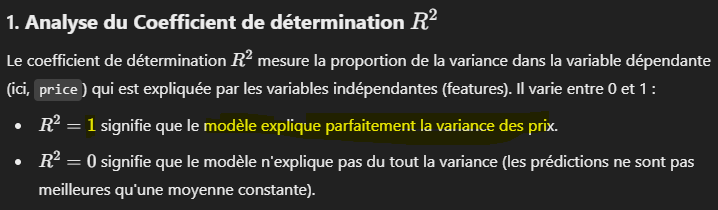
1. Coefficient de détermination R² = 0.405 mesure la proportion de la variance dans la variable cible (le prix des maisons) qui est expliquée par les variables explicatives (les features) dans le modèle.
   En d'autres termes, c'est une mesure de la qualité de l'ajustement du modèle.
Une valeur de 0.405 signifie que le modèle explique environ 40.5% de la variance dans les prix des maisons. Cela indique que le modèle capture une partie significative de l'information, mais il laisse encore 59.5% de la variance non expliquée.   
Une valeur relativement faible comme celle-ci suggère qu'il existe probablement des variables importantes qui ne sont pas prises en compte ou que le modèle linéaire ne capture pas bien les relations complexes entre les features et la cible.   
Comment l'interpréter : Un R² de 0.405 n'est pas mauvais, mais il montre qu'il y a encore une marge d'amélioration. Cela peut signifier qu'il y a des relations non linéaires que le modèle linéaire ne peut pas capter.

3. Interprétation du RMSE :
Le RMSE est une mesure de l'erreur moyenne de nos prédictions en tenant compte de la même unité que la variable cible. Dans ce cas, cela signifie que le modèle fait des erreurs moyennes de l'ordre de 152.221 USD sur les prix des maisons, ce qui semble être une erreur assez importante.   
Si l'on compare cette valeur à la distribution des prix dans ton dataset (d'après le describe() initial, le prix moyen était autour de 450,000 avec un écart-type de 192.678), l'erreur est significative, représentant environ 33.8% du prix moyen des maisons.   
Cela renforce l'idée que le modèle linéaire n'explique pas bien les variations du prix et que des améliorations peuvent être apportées.


## D. Visualisation des résultats
Nous allons maintenant tracer un graphique montrant la comparaison entre les prix réels et les prix prédits par le modèle pour visualiser la qualité des prédictions.

- Nous utilisons un graphique de dispersion pour visualiser la relation entre les prix réels et les prix prédits. La ligne rouge représente une prédiction parfaite (où les prix réels seraient égaux aux prix prédits).

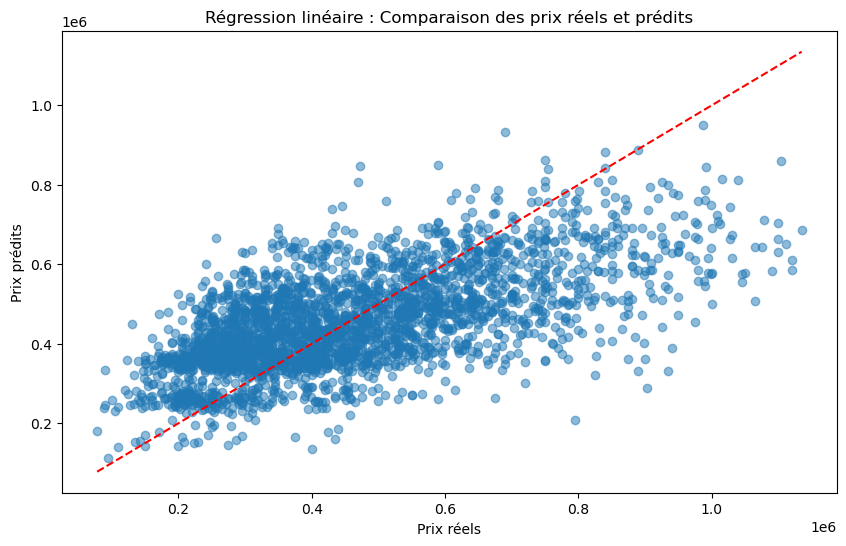

In [412]:
import matplotlib.pyplot as plt

# Tracer les prix réels vs les prix prédits
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')  # Ligne d'identité
plt.xlabel('Prix réels')
plt.ylabel('Prix prédits')
plt.title('Régression linéaire : Comparaison des prix réels et prédits')
plt.show()


## E. Évaluation des Performances du Modèle avec un Graphique Résiduel
Un graphique résiduel permet de visualiser la différence entre les prix réels et les prix prédits par le modèle. Idéalement, les résidus doivent être répartis de manière homogène autour de la ligne horizontale à zéro.

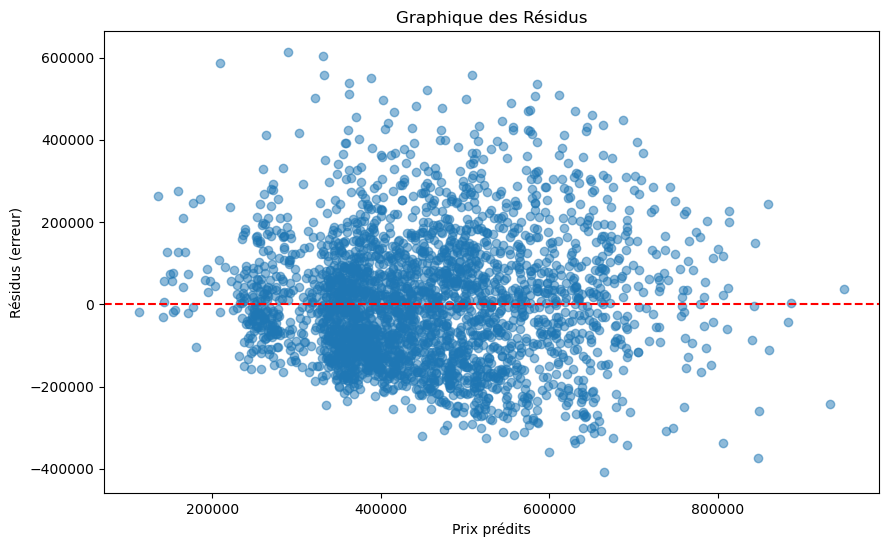

In [414]:
# Calculer les résidus (erreur entre la prédiction et la réalité)
residuals = y_test - y_pred

# Tracer le graphique des résidus
plt.figure(figsize=(10, 6))
plt.scatter(y_pred, residuals, alpha=0.5)
plt.axhline(y=0, color='r', linestyle='--')
plt.xlabel('Prix prédits')
plt.ylabel('Résidus (erreur)')
plt.title('Graphique des Résidus')
plt.show()


## F. Réaliser 3 Prédictions
Pour effectuer des prédictions, nous avons besoin de nouvelles données ou d'échantillons existants dans le dataset. Si vous avez des exemples spécifiques, vous pouvez les fournir, mais je vais générer trois exemples en sélectionnant trois maisons aléatoires de l'ensemble de test.

In [416]:
# Créer de nouveaux exemples (non normalisés)
new_samples = pd.DataFrame({
    'sqft_living': [2000, 3000, 4000],  # exemple de surface habitable
    'grade': [7, 9, 10],                # exemple de grade
    'bathrooms': [2, 3, 4],             # exemple de nombre de salles de bain
    'sqft_living15': [1800, 2500, 3500],# surface habitable des voisins
    'sqft_basement': [500, 800, 1200]   # surface du sous-sol
})

# Normaliser ces nouveaux exemples avec le même scaler utilisé sur l'entraînement
scaler = StandardScaler()
scaler.fit(X_train)  # Ajuster le scaler sur les données d'entraînement

# Normaliser uniquement les nouvelles features
new_samples_normalized = scaler.transform(new_samples)

# Faire la prédiction sur les exemples normalisés
predictions = linear_model.predict(new_samples_normalized)

# Afficher les résultats
for i, pred in enumerate(predictions):
    print(f"Exemple {i+1} :")
    print(new_samples.iloc[i])
    print(f"Prix prédit : {pred:.2f} USD\n")



Exemple 1 :
sqft_living      2000
grade               7
bathrooms           2
sqft_living15    1800
sqft_basement     500
Name: 0, dtype: int64
Prix prédit : 133701962.11 USD

Exemple 2 :
sqft_living      3000
grade               9
bathrooms           3
sqft_living15    2500
sqft_basement     800
Name: 1, dtype: int64
Prix prédit : 197711554.03 USD

Exemple 3 :
sqft_living      4000
grade              10
bathrooms           4
sqft_living15    3500
sqft_basement    1200
Name: 2, dtype: int64
Prix prédit : 271764777.69 USD



C:\Users\user\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


In [334]:
import folium
from folium.plugins import FastMarkerCluster

# Calculer la position centrale de la carte (moyenne des latitudes et longitudes)
map_center = [house_data['lat'].mean(), house_data['long'].mean()]

# Créer la carte centrée sur la région des maisons
house_map = folium.Map(location=map_center, zoom_start=10)

# Créer une liste de tuples (latitude, longitude) pour FastMarkerCluster
locations = list(zip(house_data['lat'], house_data['long']))

# Utiliser FastMarkerCluster pour ajouter les points
FastMarkerCluster(locations).add_to(house_map)

# Sauvegarder la carte ou l'afficher
house_map.save('data/house_map_fast.html')
house_map


## A. Colorer les Points en Fonction du Prix des Maisons
Nous pouvons également ajouter une fonctionnalité qui colorie les points en fonction du prix des maisons pour une meilleure visualisation de la répartition des prix dans la région.
- price_color() : Cette fonction attribue une couleur différente à chaque point en fonction du prix des maisons (vert pour les prix bas, orange pour les prix moyens, rouge pour les prix élevés).
- folium.CircleMarker() : Utilisé à la place de Marker pour créer des marqueurs de forme circulaire avec des couleurs personnalisées.

In [336]:
import folium

# Calculer la position centrale de la carte (moyenne des latitudes et longitudes)
map_center = [house_data['lat'].mean(), house_data['long'].mean()]

# Créer la carte centrée sur la région des maisons
house_map = folium.Map(location=map_center, zoom_start=10)

# Créer une fonction pour attribuer des couleurs en fonction du prix
def price_color(price):
    if price < 300000:
        return 'green'
    elif 300000 <= price < 600000:
        return 'orange'
    else:
        return 'red'

# Limiter à un sous-ensemble de points pour accélérer la carte (par exemple, afficher seulement 1000 points)
sampled_data = house_data #.sample(1000)  # Vous pouvez ajuster ce nombre

# Ajouter des marqueurs colorés en fonction du prix
for idx, row in sampled_data.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=5,
        color=price_color(row['price']),
        fill=True,
        fill_opacity=0.7,
        popup=f"Prix: {row['price']} USD\nSurface: {row['sqft_living']} sqft"
    ).add_to(house_map)

# Sauvegarder la carte et l'afficher
house_map.save('data/house_map_colored.html')
house_map
